In [1]:
# Import libraries

import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8)

pd.options.mode.chained_assignment = None


# Read data

df = pd.read_csv(r'C:\Users\alvin\Downloads\metacritic_best_albums_of_all_time.csv')

In [2]:
# Look at first five data

df.head()

,rank,title,artist,release,summary,metascore,userscore,link,img_url
0,1,Ten Freedom Summers,Wadada Leo Smith,"May 22, 2012",The four-disc set from the jazz trumpeter was ...,99,4.3,https://www.metacritic.com/music/ten-freedom-s...,https://static.metacritic.com/images/products/...
1,2,Fetch the Bolt Cutters,Fiona Apple,"April 17, 2020",The fifth full-length studio release for the a...,98,8.1,https://www.metacritic.com/music/fetch-the-bol...,https://static.metacritic.com/images/products/...
2,3,SMiLE,Brian Wilson,"September 28, 2004","Well, better 37 years late than never. Origina...",97,7.9,https://www.metacritic.com/music/smile/brian-w...,https://static.metacritic.com/images/products/...
3,4,Van Lear Rose,Loretta Lynn,"April 27, 2004",It's been over 40 years since she released her...,97,8.4,https://www.metacritic.com/music/van-lear-rose...,https://static.metacritic.com/images/products/...
4,5,To Pimp A Butterfly,Kendrick Lamar,"March 16, 2015",The third full-length studio release from the ...,96,8.9,https://www.metacritic.com/music/to-pimp-a-but...,https://static.metacritic.com/images/products/...


In [3]:
# Data Types for our columns

print(df.dtypes)

rank          int64
title        object
artist       object
release      object
summary      object
metascore     int64
userscore    object
link         object
img_url      object
dtype: object


In [4]:
# Check for any missing data
# Loop through the data and see if there is anything missing

for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))  

rank - 0%
title - 0%
artist - 0%
release - 0%
summary - 1%
metascore - 0%
userscore - 0%
link - 0%
img_url - 0%


In [5]:
# Create new column, year released of the albums,

df['year_release'] = df['release'].astype(str).str[-4:]

df.head()

,rank,title,artist,release,summary,metascore,userscore,link,img_url,year_release
0,1,Ten Freedom Summers,Wadada Leo Smith,"May 22, 2012",The four-disc set from the jazz trumpeter was ...,99,4.3,https://www.metacritic.com/music/ten-freedom-s...,https://static.metacritic.com/images/products/...,2012
1,2,Fetch the Bolt Cutters,Fiona Apple,"April 17, 2020",The fifth full-length studio release for the a...,98,8.1,https://www.metacritic.com/music/fetch-the-bol...,https://static.metacritic.com/images/products/...,2020
2,3,SMiLE,Brian Wilson,"September 28, 2004","Well, better 37 years late than never. Origina...",97,7.9,https://www.metacritic.com/music/smile/brian-w...,https://static.metacritic.com/images/products/...,2004
3,4,Van Lear Rose,Loretta Lynn,"April 27, 2004",It's been over 40 years since she released her...,97,8.4,https://www.metacritic.com/music/van-lear-rose...,https://static.metacritic.com/images/products/...,2004
4,5,To Pimp A Butterfly,Kendrick Lamar,"March 16, 2015",The third full-length studio release from the ...,96,8.9,https://www.metacritic.com/music/to-pimp-a-but...,https://static.metacritic.com/images/products/...,2015


In [6]:
# Drop any duplicates

df.drop_duplicates()

,rank,title,artist,release,summary,metascore,userscore,link,img_url,year_release
0,1,Ten Freedom Summers,Wadada Leo Smith,"May 22, 2012",The four-disc set from the jazz trumpeter was ...,99,4.3,https://www.metacritic.com/music/ten-freedom-s...,https://static.metacritic.com/images/products/...,2012
1,2,Fetch the Bolt Cutters,Fiona Apple,"April 17, 2020",The fifth full-length studio release for the a...,98,8.1,https://www.metacritic.com/music/fetch-the-bol...,https://static.metacritic.com/images/products/...,2020
2,3,SMiLE,Brian Wilson,"September 28, 2004","Well, better 37 years late than never. Origina...",97,7.9,https://www.metacritic.com/music/smile/brian-w...,https://static.metacritic.com/images/products/...,2004
3,4,Van Lear Rose,Loretta Lynn,"April 27, 2004",It's been over 40 years since she released her...,97,8.4,https://www.metacritic.com/music/van-lear-rose...,https://static.metacritic.com/images/products/...,2004
4,5,To Pimp A Butterfly,Kendrick Lamar,"March 16, 2015",The third full-length studio release from the ...,96,8.9,https://www.metacritic.com/music/to-pimp-a-but...,https://static.metacritic.com/images/products/...,2015
...,...,...,...,...,...,...,...,...,...,...
12792,12966,One,Dirty Vegas,"November 30, 2004",The UK dance trio returns with a sophomore rel...,35,2.4,https://www.metacritic.com/music/one/dirty-vegas,https://static.metacritic.com/images/products/...,2004
12793,12967,Testify,Phil Collins,"November 12, 2002",Phil Collins returns with his first album of n...,34,6.2,https://www.metacritic.com/music/testify/phil-...,https://static.metacritic.com/images/products/...,2002
12794,12968,Famous First Words,Viva Brother,"August 1, 2011","The debut album for the British pop rock band,...",34,2.5,https://www.metacritic.com/music/famous-first-...,https://static.metacritic.com/images/products/...,2011
12795,12969,Results May Vary,Limp Bizkit,"September 23, 2003",The critics were not kind to this follow-up to...,33,4.2,https://www.metacritic.com/music/results-may-v...,https://static.metacritic.com/images/products/...,2003


In [7]:
# Sorting data by 'userscore' to drop rows with 'tbd' later

df.sort_values(by=['userscore'], inplace= False, ascending=False)

,rank,title,artist,release,summary,metascore,userscore,link,img_url,year_release
6355,6445,Armonico Hewa,OOIOO,"October 20, 2009",The latest album for the Japanese quartet is t...,74,tbd,https://www.metacritic.com/music/armonico-hewa...,https://static.metacritic.com/images/products/...,2009
2694,2716,Regifted Light,Baby Dee,"March 14, 2011",The Cleveland-born transgender singer-songwrit...,80,tbd,https://www.metacritic.com/music/regifted-ligh...,https://static.metacritic.com/images/products/...,2011
6656,6747,Exister,Hot Water Music,"May 15, 2012",The first release in over eight years for the ...,74,tbd,https://www.metacritic.com/music/exister/hot-w...,https://static.metacritic.com/images/products/...,2012
6651,6742,Stranger On The Sofa,Barry Adamson,"June 13, 2006",The producer and former Bad Seeds member retur...,74,tbd,https://www.metacritic.com/music/stranger-on-t...,https://static.metacritic.com/images/products/...,2006
6648,6739,1619 Broadway: The Brill Building Project,Kurt Elling,"September 25, 2012",The Grammy-winning jazz singer covers songs by...,74,tbd,https://www.metacritic.com/music/1619-broadway...,https://static.metacritic.com/images/products/...,2012
...,...,...,...,...,...,...,...,...,...,...
12783,12957,BAYTL,V-Nasty,"December 13, 2011",This is the debut album for the collaboration ...,39,2.1,https://www.metacritic.com/music/baytl/gucci-mane,https://static.metacritic.com/images/products/...,2011
12763,12937,Memories: Do Not Open,The Chainsmokers,"April 7, 2017",The debut full-length release for the electron...,43,2.1,https://www.metacritic.com/music/memories-do-n...,https://static.metacritic.com/images/products/...,2017
12786,12960,DUMMY BOY,6ix9ine,"November 27, 2018",The debut full-length studio release for the r...,38,1.7,https://www.metacritic.com/music/dummy-boy/6ix...,https://static.metacritic.com/images/products/...,2018
12677,12851,Paula,Robin Thicke,"July 1, 2014",The seventh full-length studio release for the...,49,1.5,https://www.metacritic.com/music/paula/robin-t...,https://static.metacritic.com/images/products/...,2014


In [8]:
pd.set_option('display.max_rows', None)

In [9]:
# Drop column 'release'

df.drop(['release'], axis=1, inplace=True)
df.describe()

,rank,metascore
count,12797.000000,12797.000000
mean,6481.533563,73.178948
std,3749.316156,8.239035
min,1.000000,15.000000
25%,3226.000000,69.000000
50%,6488.000000,74.000000
75%,9729.000000,79.000000
max,12970.000000,99.000000


In [10]:
# Replace "tbd" to NaN to remove later

df.replace("tbd", np.nan, inplace = True)
df.head(5)

,rank,title,artist,summary,metascore,userscore,link,img_url,year_release
0,1,Ten Freedom Summers,Wadada Leo Smith,The four-disc set from the jazz trumpeter was ...,99,4.3,https://www.metacritic.com/music/ten-freedom-s...,https://static.metacritic.com/images/products/...,2012
1,2,Fetch the Bolt Cutters,Fiona Apple,The fifth full-length studio release for the a...,98,8.1,https://www.metacritic.com/music/fetch-the-bol...,https://static.metacritic.com/images/products/...,2020
2,3,SMiLE,Brian Wilson,"Well, better 37 years late than never. Origina...",97,7.9,https://www.metacritic.com/music/smile/brian-w...,https://static.metacritic.com/images/products/...,2004
3,4,Van Lear Rose,Loretta Lynn,It's been over 40 years since she released her...,97,8.4,https://www.metacritic.com/music/van-lear-rose...,https://static.metacritic.com/images/products/...,2004
4,5,To Pimp A Butterfly,Kendrick Lamar,The third full-length studio release from the ...,96,8.9,https://www.metacritic.com/music/to-pimp-a-but...,https://static.metacritic.com/images/products/...,2015


In [11]:
df.sort_values(by=['userscore'], inplace= False, ascending=False)

,rank,title,artist,summary,metascore,userscore,link,img_url,year_release
2807,2829,Blue Banisters,Lana Del Rey,The eighth full-length studio release for the ...,80,9.6,https://www.metacritic.com/music/blue-banister...,https://static.metacritic.com/images/products/...,2021
24,25,Ants From Up There,"Black Country, New Road",The second full-length release for the British...,92,9.6,https://www.metacritic.com/music/ants-from-up-...,https://static.metacritic.com/images/products/...,2022
2514,2536,The Gods We Can Touch,Aurora,The third full-length studio release for the N...,80,9.4,https://www.metacritic.com/music/the-gods-we-c...,https://static.metacritic.com/images/products/...,2022
6037,6119,Plastic Hearts,Miley Cyrus,The seventh full-length studio album from Mile...,75,9.3,https://www.metacritic.com/music/plastic-heart...,https://static.metacritic.com/images/products/...,2020
41,42,Red (Taylor's Version),Taylor Swift,The new recording of Taylor Swift's fourth stu...,91,9.3,https://www.metacritic.com/music/red-taylors-v...,https://static.metacritic.com/images/products/...,2021
1428,1438,Fearless (Taylor's Version),Taylor Swift,The first of a planned re-recording of the sin...,82,9.2,https://www.metacritic.com/music/fearless-tayl...,https://static.metacritic.com/images/products/...,2021
2714,2736,"If I Can't Have Love, I Want Power",Halsey,"Produced by Trent Reznor and Atticus Ross, the...",80,9.2,https://www.metacritic.com/music/if-i-cant-hav...,https://static.metacritic.com/images/products/...,2021
1550,1560,Map of the Soul: 7,BTS,The seventh full-length for the Korean pop ban...,82,9.2,https://www.metacritic.com/music/map-of-the-so...,https://static.metacritic.com/images/products/...,2020
4218,4271,Ancient Dreams in a Modern Land,MARINA,The fifth full-length release for the Welsh po...,77,9.2,https://www.metacritic.com/music/ancient-dream...,https://static.metacritic.com/images/products/...,2021
3224,3251,The Turning Wheel,Spellling,The third full-length release for Chrystia Cab...,79,9.2,https://www.metacritic.com/music/the-turning-w...,https://static.metacritic.com/images/products/...,2021


In [12]:
# Evaluating for Missing Data

missing_data = df.isnull()
missing_data.head(5)

,rank,title,artist,summary,metascore,userscore,link,img_url,year_release
0,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False


In [13]:
# Drop rows in userscore which includes 'NaN'

df.dropna(subset=["userscore"], axis=0, inplace = True)

In [14]:
# View all data in userscore ascending

df.sort_values(by=['userscore'], inplace= False, ascending=False)

,rank,title,artist,summary,metascore,userscore,link,img_url,year_release
2807,2829,Blue Banisters,Lana Del Rey,The eighth full-length studio release for the ...,80,9.6,https://www.metacritic.com/music/blue-banister...,https://static.metacritic.com/images/products/...,2021
24,25,Ants From Up There,"Black Country, New Road",The second full-length release for the British...,92,9.6,https://www.metacritic.com/music/ants-from-up-...,https://static.metacritic.com/images/products/...,2022
2514,2536,The Gods We Can Touch,Aurora,The third full-length studio release for the N...,80,9.4,https://www.metacritic.com/music/the-gods-we-c...,https://static.metacritic.com/images/products/...,2022
6037,6119,Plastic Hearts,Miley Cyrus,The seventh full-length studio album from Mile...,75,9.3,https://www.metacritic.com/music/plastic-heart...,https://static.metacritic.com/images/products/...,2020
41,42,Red (Taylor's Version),Taylor Swift,The new recording of Taylor Swift's fourth stu...,91,9.3,https://www.metacritic.com/music/red-taylors-v...,https://static.metacritic.com/images/products/...,2021
1428,1438,Fearless (Taylor's Version),Taylor Swift,The first of a planned re-recording of the sin...,82,9.2,https://www.metacritic.com/music/fearless-tayl...,https://static.metacritic.com/images/products/...,2021
2714,2736,"If I Can't Have Love, I Want Power",Halsey,"Produced by Trent Reznor and Atticus Ross, the...",80,9.2,https://www.metacritic.com/music/if-i-cant-hav...,https://static.metacritic.com/images/products/...,2021
1550,1560,Map of the Soul: 7,BTS,The seventh full-length for the Korean pop ban...,82,9.2,https://www.metacritic.com/music/map-of-the-so...,https://static.metacritic.com/images/products/...,2020
4218,4271,Ancient Dreams in a Modern Land,MARINA,The fifth full-length release for the Welsh po...,77,9.2,https://www.metacritic.com/music/ancient-dream...,https://static.metacritic.com/images/products/...,2021
3224,3251,The Turning Wheel,Spellling,The third full-length release for Chrystia Cab...,79,9.2,https://www.metacritic.com/music/the-turning-w...,https://static.metacritic.com/images/products/...,2021


In [14]:
# Build a bin array with a minimum value to a maximum value

bins = np.linspace(min(df["metascore"]), max(df["metascore"]), 4)
bins

array([15., 43., 71., 99.])

In [15]:
group_names = ['Low', 'Medium', 'High']

In [16]:
df['metascore-binned'] = pd.cut(df['metascore'], bins, labels=group_names, include_lowest=True )
df[['metascore','metascore-binned']]

,metascore,metascore-binned
0,99,High
1,98,High
2,97,High
3,97,High
4,96,High
5,96,High
6,96,High
7,95,High
8,95,High
9,95,High


In [17]:
# Let's see the number of albums in each bin

df["metascore-binned"].value_counts()

High      5825
Medium    3287
Low         37
Name: metascore-binned, dtype: int64

Text(0.5, 1.0, 'Metascore bins')

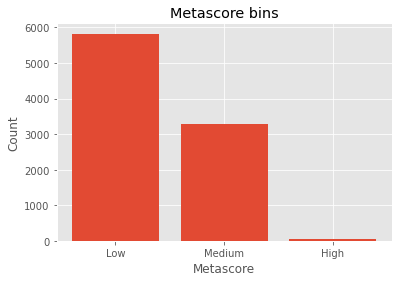

In [18]:
# Let's plot the distribution of each bin

%matplotlib inline
import matplotlib as plt
from matplotlib import pyplot
pyplot.bar(group_names, df["metascore-binned"].value_counts())

plt.pyplot.xlabel("Metascore")
plt.pyplot.ylabel("Count")
plt.pyplot.title("Metascore bins")